# DCGAN Tutorial

Pytorch: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#dcgan-tutorial

In [1]:
# imports

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.utils.data
from torch.utils.data.dataloader import DataLoader
import torchvision.transforms as ts
import torch.optim as optim
import torchvision.datasets as ds
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

from generator import Generator
from discriminator import Discriminator
from utils import *

seeds_count = 999
random.seed(seeds_count)

torch.manual_seed(seeds_count)
torch.use_deterministic_algorithms(True)

In [10]:
# Global variables

dataroot = "/archive"
image_resized_size = 64
num_workers = 2
n_generator_input = 100
n_image_channels = 3
n_epochs = 5

ngpu = torch.cuda.device_count()
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

print(device, ngpu)

for i in range(ngpu):
    print(torch.cuda.get_device_properties(i).name)

cuda:0 2
Quadro RTX 8000
Quadro P1000


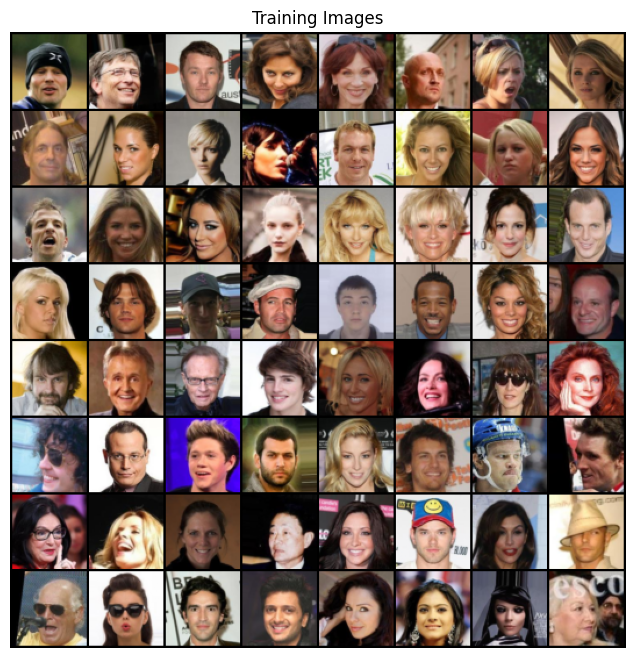

In [3]:
dataset = ds.ImageFolder(
    root=dataroot,
    transform=ts.Compose([
        ts.Resize(image_resized_size),
        ts.CenterCrop(image_resized_size),
        ts.ToTensor(),
        ts.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
)

dataloader = DataLoader(dataset, batch_size=128,shuffle=True, num_workers=num_workers)
real_batch = next(iter(dataloader))

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

### Generator instance  

In [11]:
netG = Generator(ngpu, n_generator_input, n_image_channels).to(device)

if ngpu > 1 and (device.type == 'cuda'):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

### Discriminator

In [12]:
netD = Discriminator(ngpu, n_image_channels).to(device)

if ngpu > 1 and (device.type == 'cuda'):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    

# Initiate loss function and Optimizers

In [15]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, n_generator_input, 1, 1, device=device)

real_label = 1.0
fake_label = 0.0

optmizer_netg = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))
optmizer_netd = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Training Process


In [17]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Training Start")

for epoch in range(n_epochs):
    
    for batch_idx, data in enumerate(dataloader):
        #Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        netD.zero_grad()
        
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
        
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        Dx = output.mean().item()
        
        noise = torch.randn(batch_size, n_generator_input, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        
        DD = output.mean().item()
        errD = errD_real + errD_fake
        optmizer_netd.step()
        
        # Update G network: maximize log(D(G(z)))
        netG.zero_grad()
        label.fill_(real_label)
        
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        
        DG = output.mean().item()
        optmizer_netg.step()
        
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, n_epochs, i, len(dataloader),
                     errD.item(), errG.item(), Dx, DD, DG))
            
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        if (iters % 500 == 0) or ((epoch == n_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        

Training Start


C:\Python38\lib\site-packages\torch\cuda\nccl.py:16: UserWarning: PyTorch is not compiled with NCCL support
  warnings.warn("PyTorch is not compiled with NCCL support")


In [18]:
print(img_list)

[tensor([[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.4802,  ..., 0.5432, 0.0000, 0.0000],
         ...,
         [0.0000, 0.0000, 0.5226,  ..., 0.5200, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.5628,  ..., 0.5263, 0.0000, 0.0000],
         ...,
         [0.0000, 0.0000, 0.4959,  ..., 0.5200, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.5290,  ..., 0.5200, 0.0000, 0

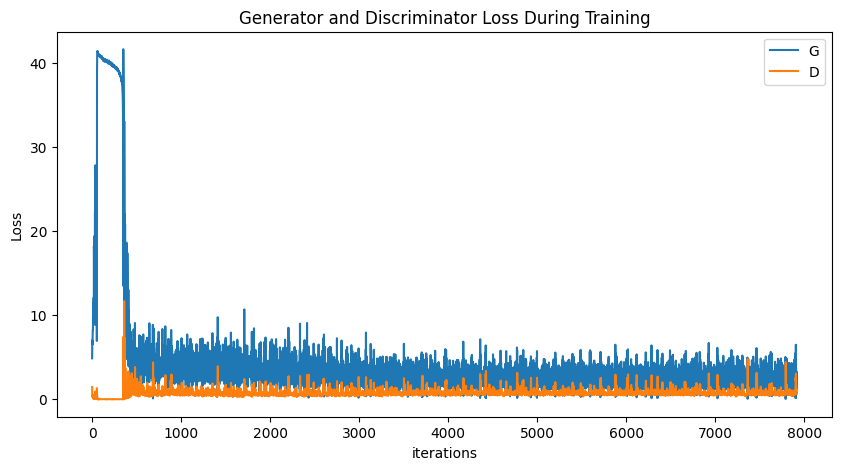

In [19]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

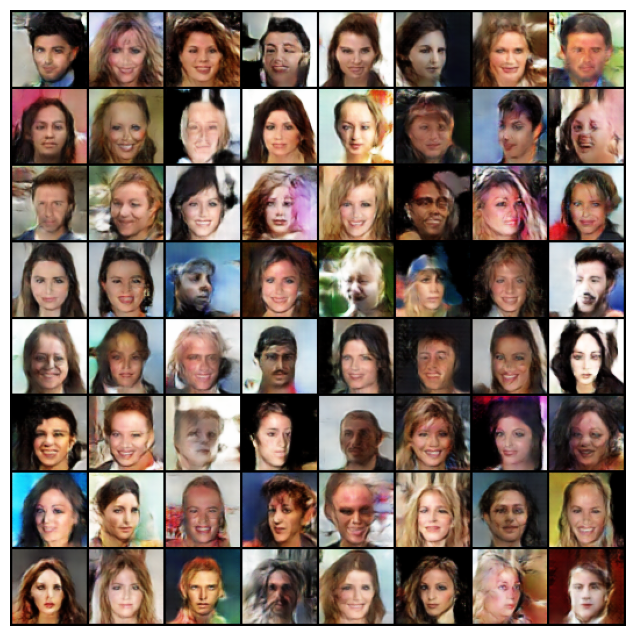

In [25]:
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [26]:
## Save generator and discriminator
# 
torch.save(netG.state_dict(), 'netG.pth')
torch.save(netD.state_dict(), 'netD.pth')
torch.save(img_list, 'img_list.pth')